<a href="https://colab.research.google.com/github/olvad/DeepLearning_course/blob/main/HW_TimeSeries.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<center><img src="https://github.com/hse-ds/iad-applied-ds/blob/master/2021/hw/hw1/img/logo_hse.png?raw=1" width="1000"></center>

<h1><center>Прикладные задачи анализа данных</center></h1>
<h2><center>Домашнее задание 3: прогнозирование временных рядов</center></h2>

**Мягкий дедлайн:** 23:59MSK 19.05.2024

**Жесткий дедлайн:** 23:59MSK 26.05.2024

In [ ]:
!pip install -r requirements.txt

In [ ]:
import warnings
import gdown
import pandas as pd
import numpy as np
from copy import deepcopy

warnings.filterwarnings("ignore")

В данной задаче мы будем решать одну из актуальных практических задач, с которыми, в том числе, сталкиваются разработчики ETNA - прогнозирование объема необходимой наличности в банкоматах. Пожалуй, ни для кого не секрет, что отсутствие необходимой суммы в банкомате не делает клиента банка счастливее. В то же время, избыток заправленной в банкомат наличности приводит к упущенной выгоде - ведь, в конечном счете, эти деньги могли быть размещены в качестве краткосрочного депозита на межбанковском рынке. Для кредитной организации с обширной сетью банкоматов даже незначительное улучшение качества предсказания способно внести значительный вклад в прибыльность этой ветки бизнеса.

В качестве инструмента воспользуемся библиотекой ETNA, документацию можно прочитать [тут](https://docs.etna.ai/stable/), и [чат](https://t.me/etna_support) комьюнити.

Мы будем использовать дневные данные реальных банкоматов для чего возьмем мультисегментный датасет.

In [ ]:
url = 'https://gist.githubusercontent.com/Polzovat123/4d6d5e544e93429c2d3db29196e9c918/raw/24b27e60f587128d71678e267f51cd48472c6a84/atms_daily_cash.csv'
output = 'atms_daily_cash.csv'
gdown.download(url=url, output=output, quiet=False, fuzzy=True)

df = pd.read_csv('atms_daily_cash.csv', index_col=False)

Downloading...
From: https://gist.githubusercontent.com/Polzovat123/4d6d5e544e93429c2d3db29196e9c918/raw/24b27e60f587128d71678e267f51cd48472c6a84/atms_daily_cash.csv
To: /content/atms_daily_cash.csv
100%|██████████| 258k/258k [00:00<00:00, 4.91MB/s]


Полученные данные были просуммированы по банкоматам и дням эксплуатации, после чего залиты в gist, откуда мы и берем их.

Взглянем на то, что представляют из себя данные после этих действий:

In [ ]:
df.head()

,datetime,atm_id,operation_value
0,2017-08-16,74,2.059266
1,2017-08-17,74,1.029633
2,2017-08-18,74,0.686422
3,2017-08-19,74,33.301267
4,2017-08-20,74,-12.237921


In [ ]:
df.atm_id.unique()

array([ 74,  85,  86,  87,  88,  90,  91,  93,  94,  96,  97,  98,  99,
       100, 101, 102, 103, 104, 105, 106])

### Задание 1. EDA (1.75 балл)

Проведите разведывательный анализ данных с помощью `ETNA`- постройте графики, на которых можно судить о наличии тренда, сезонности и прочих зависимостей. Проанализируйте корреляции. Какие выводы вы можете сделать?

Ссылку на туториал по EDA можно найти [тут](https://docs.etna.ai/stable/tutorials/103-EDA.html#EDA).

In [ ]:
from etna.datasets import TSDataset

In [ ]:
df.rename(columns={'datetime': 'timestamp', 'atm_id': 'segment', 'operation_value': 'target'}, inplace=True)

In [ ]:
df

,timestamp,segment,target
0,2017-08-16,74,2.059266
1,2017-08-17,74,1.029633
2,2017-08-18,74,0.686422
3,2017-08-19,74,33.301267
4,2017-08-20,74,-12.237921
...,...,...,...
8456,2018-09-26,106,2.794718
8457,2018-09-27,106,-106.787632
8458,2018-09-28,106,153.091690
8459,2018-09-29,106,49.775392


In [ ]:
df.describe() # есть отрицательные значения

,segment,target
count,8461.000000,8401.000000
mean,94.896112,237.009769
std,8.002583,409.530419
min,74.000000,-1925.295684
25%,88.000000,26.741035
50%,96.000000,150.649989
75%,101.000000,351.663732
max,106.000000,8814.910300


In [ ]:
df_target = TSDataset(df, freq="D")

In [ ]:
df_target.describe()

,start_timestamp,end_timestamp,length,num_missing,num_segments,num_exogs,num_regressors,num_known_future,freq
segments,,,,,,,,,
100,2017-08-11,2018-09-30,416,3,20,0,0,0,D
101,2017-08-11,2018-09-30,416,3,20,0,0,0,D
102,2017-08-02,2018-09-30,425,3,20,0,0,0,D
103,2017-08-08,2018-09-30,419,3,20,0,0,0,D
104,2017-08-07,2018-09-30,420,3,20,0,0,0,D
105,2017-07-28,2018-09-30,430,3,20,0,0,0,D
106,2017-08-09,2018-09-30,418,3,20,0,0,0,D
74,2017-08-16,2018-09-30,411,3,20,0,0,0,D
85,2017-08-03,2018-09-30,424,3,20,0,0,0,D


In [ ]:
df_target.info()

<class 'etna.datasets.TSDataset'>
num_segments: 20
num_exogs: 0
num_regressors: 0
num_known_future: 0
freq: D
         start_timestamp end_timestamp  length  num_missing
segments                                                   
100           2017-08-11    2018-09-30     416            3
101           2017-08-11    2018-09-30     416            3
102           2017-08-02    2018-09-30     425            3
103           2017-08-08    2018-09-30     419            3
104           2017-08-07    2018-09-30     420            3
105           2017-07-28    2018-09-30     430            3
106           2017-08-09    2018-09-30     418            3
74            2017-08-16    2018-09-30     411            3
85            2017-08-03    2018-09-30     424            3
86            2017-08-01    2018-09-30     426            3
87            2017-06-09    2018-09-30     479            3
88            2017-08-14    2018-09-30     413            3
90            2017-07-27    2018-09-30     431    

In [ ]:
from etna.analysis import acf_plot
from etna.analysis import cross_corr_plot
from etna.analysis import distribution_plot
from etna.analysis import plot_correlation_matrix

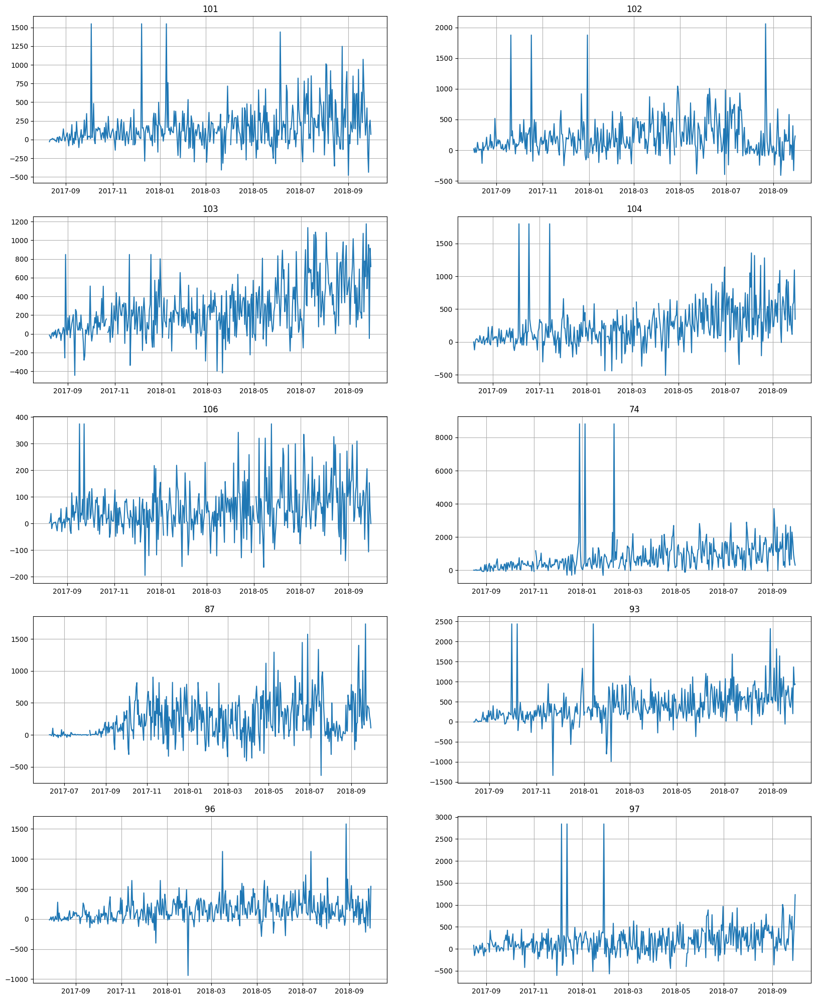

In [ ]:
df_target.plot()

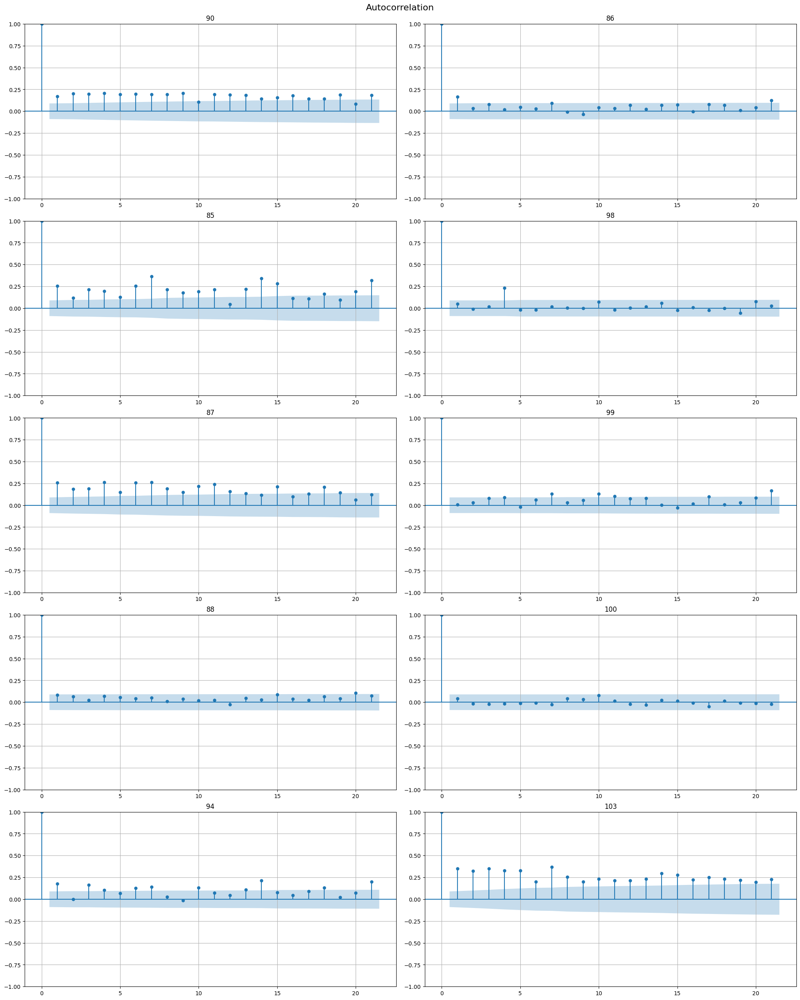

In [ ]:
acf_plot(df_target)

In [ ]:
from etna.analysis import plot_trend
from etna.transforms import LinearTrendTransform

In [ ]:

trends = [
    LinearTrendTransform(in_column="target", poly_degree=1),
    LinearTrendTransform(in_column="target", poly_degree=2),
]

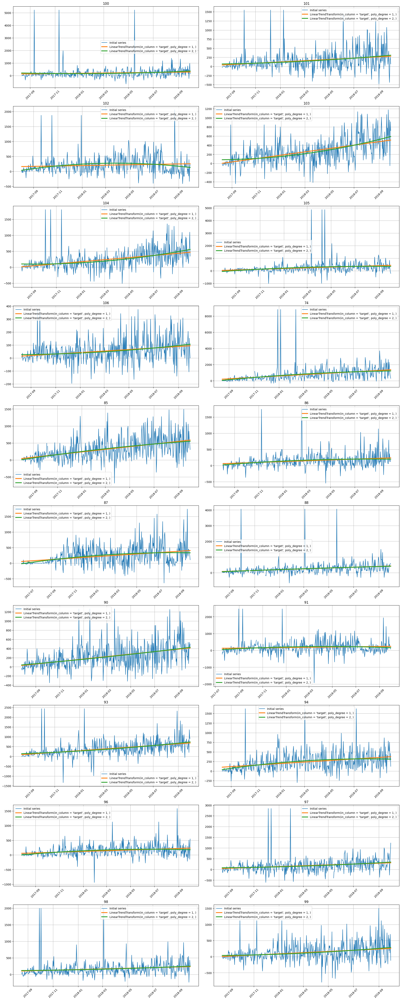

In [ ]:
plot_trend(df_target, trend_transform=trends)

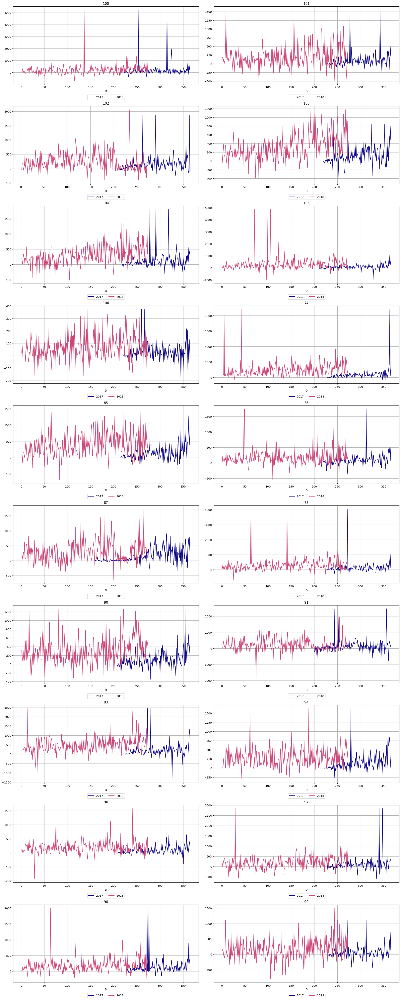

In [ ]:
from etna.analysis import stl_plot
from etna.analysis import plot_periodogram
from etna.analysis import seasonal_plot
seasonal_plot(ts=df_target, cycle="year")

### **Вывод**

> Видим что начало графиков у каждого в разные даты. Однако конец идентичен.

>Что касается графиков автокорреляций, то можно заметить наличие недельной сезонности

> На некоторых графиках виден тренд, восходящий, на некоторых его нет.

> Сезонности как таковой не наблюдается. Видно много колебаний

### Задание 2. Работа с пропущенными значениями и выбросами (1 балл)

Проанализируйте, есть ли в данных пропущенные значения, и подберите оптимальный метод их заполнения средствами ETNA. Какие методы вы выберете и почему? Совет: возможно, лучше сохранить заполненные данные в отдельный объект, поскольку некоторые модели заполняют пропуски встроенными методами, и подача на вход "сырых" данных (на языке временных рядов это данные с нерегулярными интервалами) может принести лучший результат.

Импорты всех необходимых компонент произведите самостоятельно.

Проверьте ряды на наличие выбросов, и очистите их соответствующим образом. Обоснуйте выбор.

In [ ]:
df_target2 = TSDataset(df, freq="D")

In [ ]:
df.isnull().groupby(df['segment'])['target'].sum()

segment
74     3
85     3
86     3
87     3
88     3
90     3
91     3
93     3
94     3
96     3
97     3
98     3
99     3
100    3
101    3
102    3
103    3
104    3
105    3
106    3
Name: target, dtype: int64

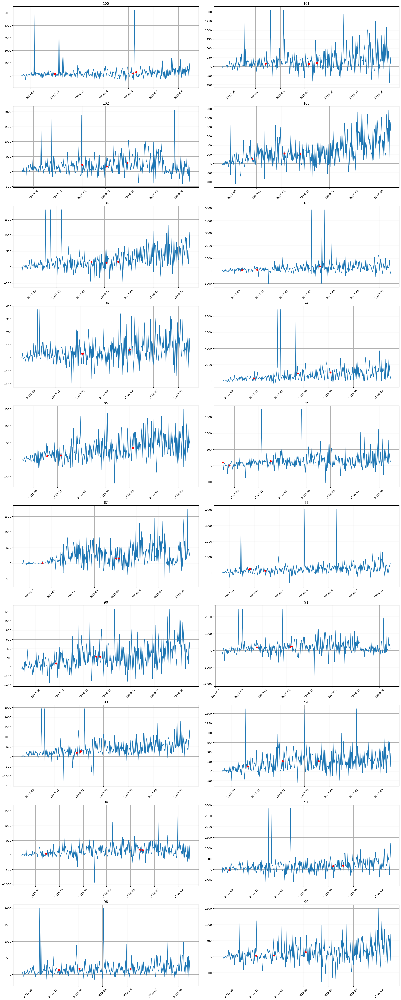

In [ ]:
from etna.transforms import TimeSeriesImputerTransform
from etna.analysis import plot_imputation
'''
If “mean”, then replace missing dates using the mean in fit stage. - не самый эффективный метод
If “running_mean” then replace missing dates using mean of subset of data
If “forward_fill” then replace missing dates using last existing value - данные постоянно меняются, поэтому не будем так делать
If “seasonal” then replace missing dates using seasonal moving average in autoregressive manner, - вряд ли подходит, нет четкой сезонности
If “constant” then replace missing dates using constant value. - не самый эффективный метод
Воспользуемсчя скользящим средним
'''

imputer = TimeSeriesImputerTransform(in_column="target", strategy="running_mean", window=30)
plot_imputation(df_target2, imputer)

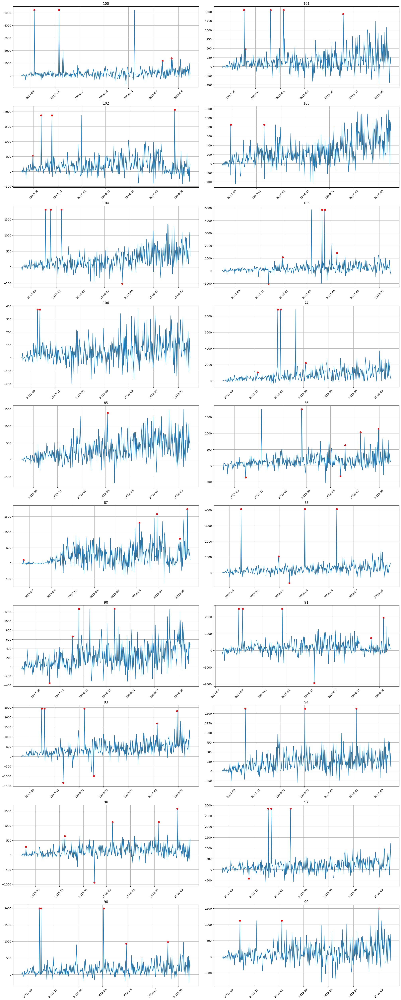

In [ ]:
'''

'''
from etna.transforms import MedianOutliersTransform
from etna.transforms import DensityOutliersTransform
from etna.analysis import get_anomalies_median
from etna.analysis import get_anomalies_density
from etna.analysis import plot_anomalies

plot_anomalies(df_target2, get_anomalies_median(df_target2, in_column = 'target', alpha = 3, window_size = 30 ))

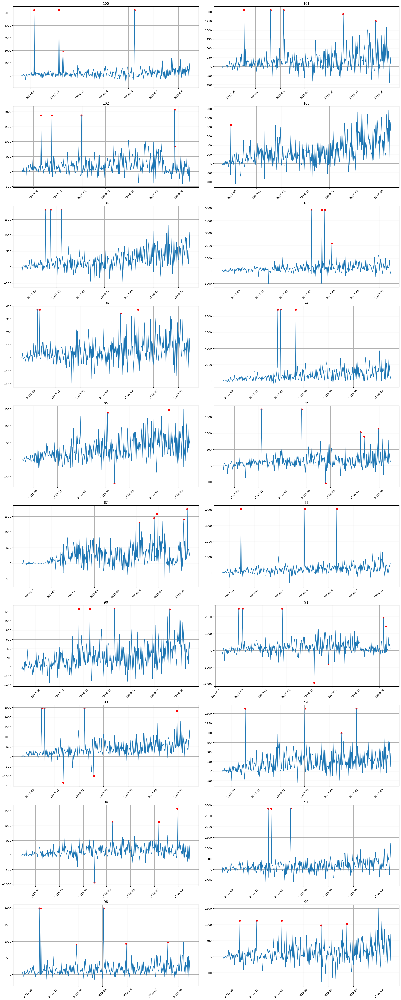

In [ ]:
plot_anomalies(df_target2, get_anomalies_density(df_target2, in_column = 'target', window_size=18, distance_coef=2 , n_neighbors=4))

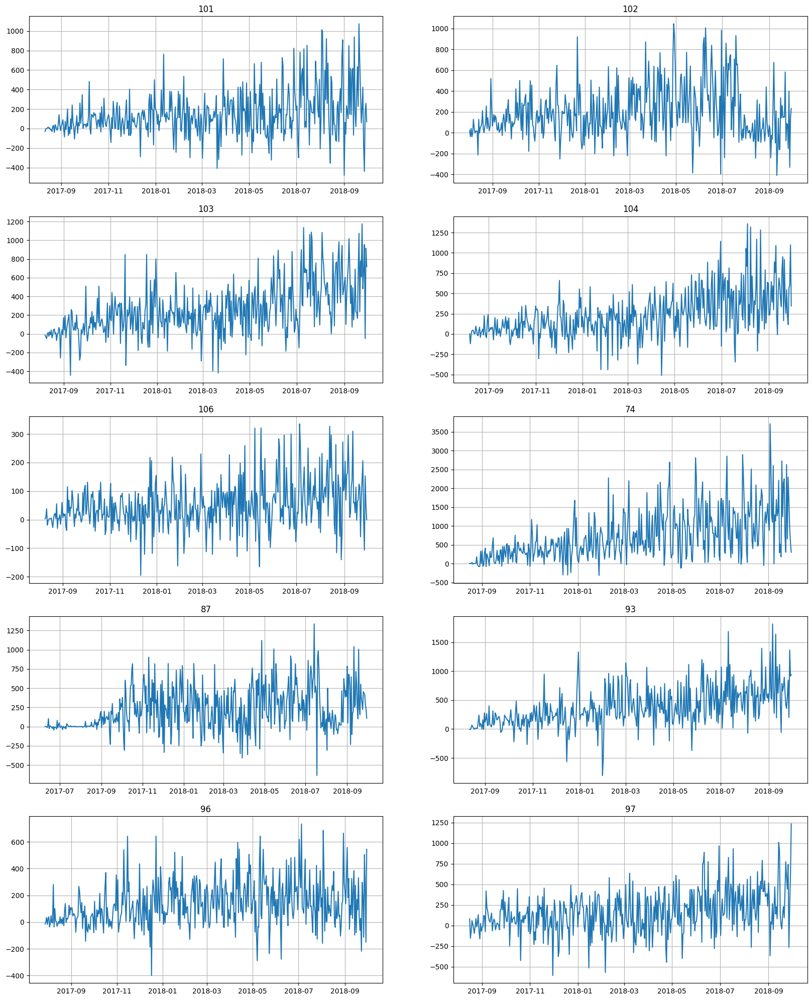

In [ ]:
outliers_remover = DensityOutliersTransform(in_column="target", window_size=18, distance_coef=2 , n_neighbors=4)
df_target2.fit_transform([outliers_remover, imputer])
df_target2.plot()

Эмпирическим путем подобрал гиперпараметры, а также выбрал метод выявления аномалий на основании плотности. Медианный метод не так работал хорошо: выделял либо лишнее, либо, наоборот, их не выделял

### Задание 3. Построение Prophet (1.25 балла)

Постройте прогнозы с помощью Prophet и `etna.Pipeline`, под капотом `etna.Pipeline` обучит `ProphetModel` для каждого сегмента в отдельности. После этого оцените качество по SMAPE на кросс-валидации. В качестве горизонта предсказания возьмите 5 дней - этого же горизонта будем придерживаться и в дальнейшем.

Отрисуйте получившийся прогноз.

In [ ]:
from etna.pipeline import Pipeline
from etna.models import ProphetModel
from etna.metrics import SMAPE, MAE
from etna.analysis import plot_backtest

In [ ]:
HORIZON = 5

In [ ]:
model = ProphetModel()

pipeline = Pipeline(
    model=ProphetModel(),
)
metrics, forecast, _ = pipeline.backtest(
    ts=df_target2, metrics=[SMAPE(), MAE()], n_folds=10, aggregate_metrics=True,
    HORIZON = 5
)


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmplq3em7el/h6zhqwkj.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmplq3em7el/ec95iujd.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=36608', 'data', 'file=/tmp/tmplq3em7el/h6zhqwkj.json', 'init=/tmp/tmplq3em7el/ec95iujd.json', 'output', 'file=/tmp/tmplq3em7el/prophet_model85m5rcdh/prophet_model-20240526072049.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
07:20:49 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
07:20:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling yearly seasonalit

In [ ]:
metrics

,segment,SMAPE,MAE
0,100,73.231196,266.905552
1,101,87.298929,243.126730
2,102,101.700105,199.432988
3,103,60.329666,320.412447
4,104,43.563565,207.933096
5,105,84.307894,245.674641
6,106,99.551277,78.695384
7,74,57.913479,646.528268
8,85,32.861087,182.920346
9,86,49.532561,129.797432


In [ ]:
metrics[['SMAPE', 'MAE']].mean()

SMAPE     68.994229
MAE      232.650356
dtype: float64

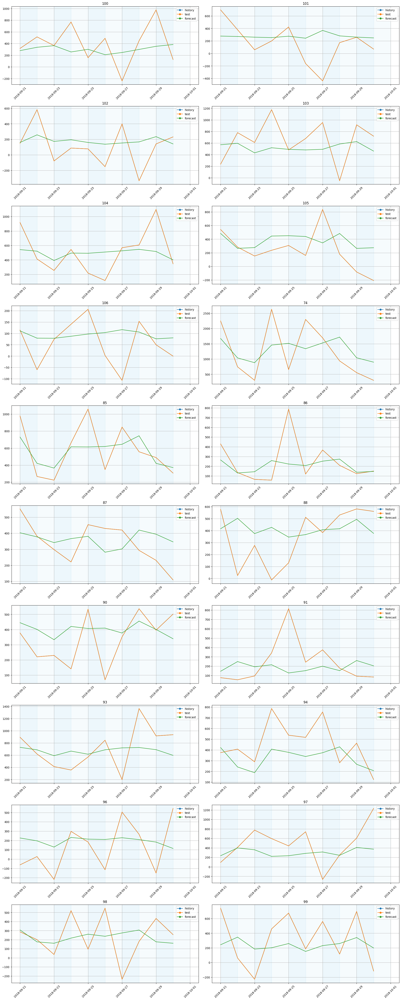

In [ ]:
plot_backtest(forecast_df=forecast, ts=df_target2)

Исходя из статистики по каждому ряду, какой можно сделать вывод о том, как лучше предсказывать итоговое значение? Посчитайте то же самое исходя из MAE.

Учитывая, что мы никаких преобразований помимо самой модели не делали, модель +- предсказывает движение. Пускай не идеально

### Задание 4. Иерархический временной ряд (2 балла)

Вопрос, поставленный в прошлом задании, тем не менее, естественным образом подводит нас к концепции **иерархического временного ряда** (когда один ряд состоит из других в качестве компонент). Это полезная концепция, которая может встретиться во многих задачах. В этом задании вам предстоит самостоятельно разобраться в деталях ее реализации в ETNA с использованием справочных материалов, предоставляемых библиотекой (как это часто бывает на практике). Они содержатся по следующей ссылке:

https://github.com/etna-team/etna/blob/master/examples/303-hierarchical_pipeline.ipynb

На выходе из первой части задания необходимо получить `TSDataset` с иерархической структурой, а также соответствующий реконсилятор, который позволит собирать искомый ряд из составных компонент. Классы, которые вам понадобятся, импортированы ниже.

In [ ]:
from etna.datasets import HierarchicalStructure
from etna.pipeline import HierarchicalPipeline
from etna.reconciliation import TopDownReconciliator

In [ ]:
list_of_ids = list(map(str, df.segment.unique().tolist()))

In [ ]:
hierarchical_structure = HierarchicalStructure(
    level_structure={"total": list_of_ids}, level_names=["total", "atm_id"]
)

hierarchical_structure

HierarchicalStructure(level_structure = {'total': ['74', '85', '86', '87', '88', '90', '91', '93', '94', '96', '97', '98', '99', '100', '101', '102', '103', '104', '105', '106']}, level_names = ['total', 'atm_id'], )

In [ ]:
'''
поскольку необходимы только положительные значения и в то же время мы хотим сравнить МАЕ,
можно прибавить константу. По математике ничего не поменяется

'''
df.target.min()

-1925.2956839167

In [ ]:
df2 = df.copy()
df2['target'] += 1926

In [ ]:
hierarchical_df = df2.copy()

In [ ]:
hierarchical_ts = TSDataset(df=hierarchical_df, freq="D", hierarchical_structure=hierarchical_structure)
hierarchical_ts.tail()

segment,100,101,102,103,104,105,106,74,85,86,87,88,90,91,93,94,96,97,98,99
feature,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target
timestamp,,,,,,,,,,,,,,,,,,,,
2018-09-26,2415.428602,1764.553575,1774.349796,2603.704316,2040.818767,2086.505046,1928.794718,4223.228473,2274.074726,2046.378785,2356.162938,2437.345072,1995.338415,2169.022761,2770.916685,2443.022761,1811.916685,2665.570539,2473.176294,2113.216663
2018-09-27,1686.507408,1487.199914,2324.467898,2879.351729,2494.916255,2762.297187,1819.212368,3619.304703,2772.975950,2293.520077,2346.081361,2308.935151,2277.575478,2300.727507,2125.748765,2679.397037,2430.549495,1661.649130,1690.390595,2486.208503
2018-09-28,2373.007730,2098.448787,1593.575693,1875.989263,2532.659652,2104.891346,2079.091690,2863.613056,2483.207859,2135.133133,2219.298261,2456.084389,2462.821129,2105.420872,3290.028130,2206.413142,2191.998282,2176.818553,2106.862358,2042.142581
2018-09-29,2902.797939,2184.761434,2066.942023,2840.431608,3023.500322,1843.011595,1975.775392,2479.560017,2415.163839,2049.820700,2157.049603,2506.889414,2321.908525,2019.372987,2842.108439,2389.364183,1776.261971,2532.012454,2359.651922,2622.149452
2018-09-30,2051.791711,1995.338415,2157.490874,2644.065922,2271.633026,1717.484647,1925.705819,2226.917543,2232.448143,2076.532317,2034.611553,2486.414430,2427.695942,2010.312218,2861.583208,2049.644192,2470.499248,3158.882328,2181.643118,1809.622074


In [ ]:
hierarchical_ts.current_df_level

'atm_id'

In [ ]:
tdr = TopDownReconciliator(target_level="atm_id", source_level = 'total' , method="AHP", period=6)

Во второй части задания примените найденные на предыдущих этапах преобразования очистку от выбросов уже к иерархическому датасету, и запустите на нем Prophet с MAE на кросс-валидации.

In [ ]:
tdr.fit(ts=hierarchical_ts) #принимает значения выше 0

TopDownReconciliator(target_level = 'atm_id', source_level = 'total', period = 6, method = 'AHP', )

In [ ]:
model = ProphetModel()

pipeline = HierarchicalPipeline(
    transforms=[
       DensityOutliersTransform(in_column="target", window_size=18, distance_coef=2 , n_neighbors=4),
       TimeSeriesImputerTransform(in_column="target", strategy="running_mean", window=30)
    ],

    model=ProphetModel(),
    reconciliator = tdr
)
metrics, forecast, _ = pipeline.backtest(
    ts=hierarchical_ts, metrics=[SMAPE(), MAE()], n_folds=10, aggregate_metrics=True
)

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmplq3em7el/66gov75z.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmplq3em7el/qp433wmf.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=43040', 'data', 'file=/tmp/tmplq3em7el/66gov75z.json', 'init=/tmp/tmplq3em7el/qp433wmf.json', 'output', 'file=/tmp/tmplq3em7el/prophet_modeljhbkjomq/prophet_model-20240526074952.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
07:49:52 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
07:49:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
[Parallel(n_jobs=1)]: Done   1 tasks    

In [ ]:
metrics

,segment,SMAPE,MAE
0,100,11.560409,264.925043
1,101,12.874797,267.845286
2,102,12.001807,243.555685
3,103,13.014182,328.334689
4,104,10.325264,253.546847
5,105,10.756103,235.237511
6,106,4.127002,81.660322
7,74,26.160678,834.772190
8,85,10.999561,276.823305
9,86,8.199998,182.402521


In [ ]:
metrics[['SMAPE', 'MAE']].mean()
# на SMAPE лучше не обращать внимание

SMAPE     11.479670
MAE      275.239507
dtype: float64

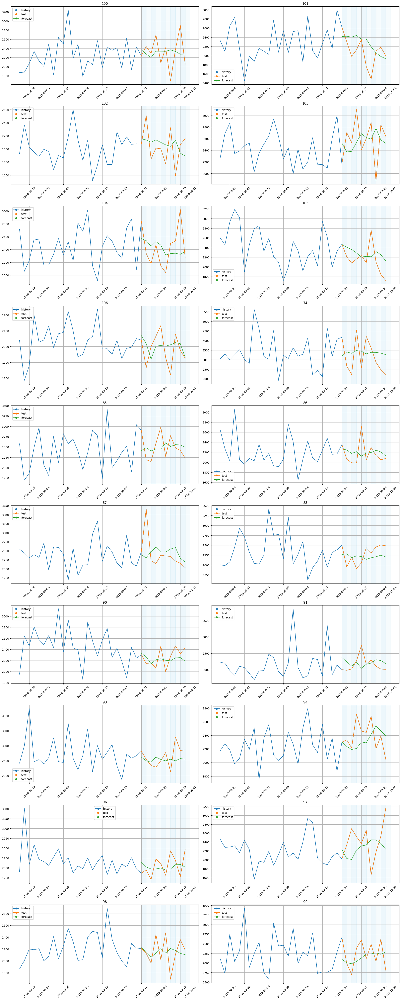

In [ ]:
plot_backtest(forecast_df=forecast, ts=hierarchical_ts, history_len=25)

MAE стал хуже

### Задание 5. Построение признаков (1.5 балла)

Вернемся к нашему исходному мультисегментному ряду - теперь поработаем с моделями, которые требуют построения признаков - `ARIMA` и `CatBoost`. Построим для них признаки, и попробуем при помощи них добиться улучшения качества.

Из обязательного:
1) постройте графики автокорреляции и при помощи них обоснуйте выбор лаговых признаков
2) для катбуста включите в признаки результаты STL разложения. STL используем для убирания тренда за счет преобразования на месте.
* Кроме этого, подумайте на экспертном уровне,
    - Какие еще закономерности могут присутствовать и почему?
    - Что из этого кажется более предсказуемым, и почему?
    - Cделайте соответствующие признаки, и снабдите их кратким комментарием.

3) После этого, обучите на получившихся признаках модели. Для `CatBoost` рассмотрите 2 версии мультисегментную и на каждый ряд в отдельности.

Ниже приведены импорты, которые вам точно понадобятся - к ним необходимо добавить те инструменты, которые вы дополнительно решите использовать в анализе.

In [ ]:
from etna.analysis import acf_plot, stl_plot
from etna.ensembles import DirectEnsemble, StackingEnsemble, VotingEnsemble
from etna.models import (CatBoostMultiSegmentModel, CatBoostPerSegmentModel,
                         AutoARIMAModel)
from etna.transforms import STLTransform, LagTransform, SegmentEncoderTransform

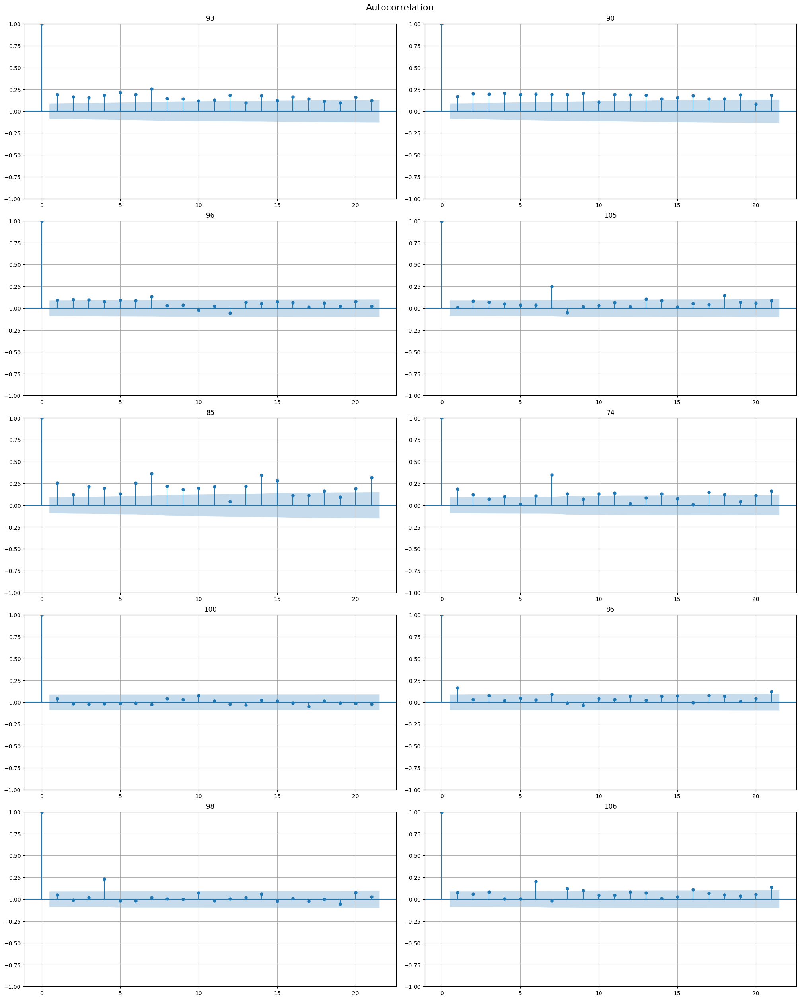

In [ ]:
acf_plot(df_target)

7 в большей степени (также 14 и 21 дни) имеют автокорреляцию. Полагаю, имеется недельная зависимость

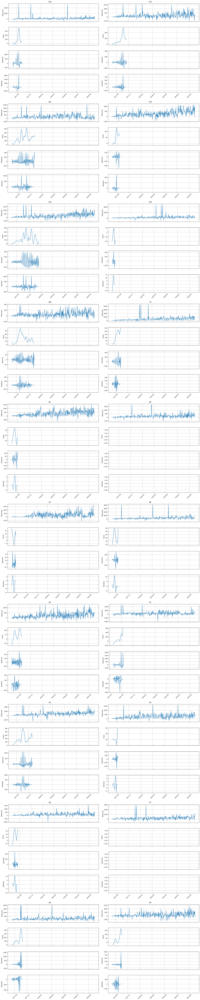

In [ ]:
stl_plot(df_target, period = 7)

In [ ]:


pipeline = Pipeline(
    transforms=[
       DensityOutliersTransform(in_column="target", window_size=18, distance_coef=2 , n_neighbors=4),
       TimeSeriesImputerTransform(in_column="target", strategy="running_mean", window=30),
       SegmentEncoderTransform(),
       LagTransform(in_column="target", lags=[1, 7, 14, 21]),
       STLTransform(in_column="target", period=7, model='arima')
    ],

    horizon=HORIZON,
    model=CatBoostMultiSegmentModel(),
)

metrics, forecast, _ = pipeline.backtest(
    ts=df_target, metrics=[SMAPE(), MAE()], n_folds=10, aggregate_metrics=True
)

[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:   12.8s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:   25.9s
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:   39.0s
[Parallel(n_jobs=1)]: Done   4 tasks      | elapsed:   51.4s
[Parallel(n_jobs=1)]: Done   5 tasks      | elapsed:  1.1min
[Parallel(n_jobs=1)]: Done   6 tasks      | elapsed:  1.3min
[Parallel(n_jobs=1)]: Done   7 tasks      | elapsed:  1.5min
[Parallel(n_jobs=1)]: Done   8 tasks      | elapsed:  1.7min
[Parallel(n_jobs=1)]: Done   9 tasks      | elapsed:  1.9min
[Parallel(n_jobs=1)]: Done  10 tasks      | elapsed:  2.1min
[Parallel(n_jobs=1)]: Done  10 tasks      | elapsed:  2.1min
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    6.7s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:   11.6s
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:   16.2s
[Parallel(n_jobs=1)]: Done   4 tasks      | elapsed:   22.4s
[Parallel(n_jobs=1)]: Done   5 tasks      | elapsed:   27.1s
[Parallel(n_jobs=1)]: Do

In [ ]:
metrics

,segment,SMAPE,MAE
0,100,94.319388,386.042123
1,101,115.146130,440.705445
2,102,149.430891,372.671474
3,103,69.590667,383.008941
4,104,77.360672,417.788562
5,105,103.752121,433.839206
6,106,102.527932,166.591427
7,74,60.284835,748.903819
8,85,83.226461,407.457224
9,86,101.300509,287.214772


In [ ]:
metrics[['SMAPE',	'MAE']].mean()

SMAPE     95.004097
MAE      377.771314
dtype: float64

In [ ]:
pipeline = Pipeline(
    transforms=[
       DensityOutliersTransform(in_column="target", window_size=18, distance_coef=2 , n_neighbors=4),
       TimeSeriesImputerTransform(in_column="target", strategy="running_mean", window=30),
       SegmentEncoderTransform(),
       LagTransform(in_column="target", lags=[1, 7, 14, 21]),
       STLTransform(in_column="target", period=7, model='arima')
    ],

    horizon=HORIZON,
    model=CatBoostPerSegmentModel(),
)

metrics, forecast, _ = pipeline.backtest(
    ts=df_target, metrics=[SMAPE(), MAE()], n_folds=10, aggregate_metrics=True
)

[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:   30.9s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:  1.1min
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:  1.6min
[Parallel(n_jobs=1)]: Done   4 tasks      | elapsed:  2.1min
[Parallel(n_jobs=1)]: Done   5 tasks      | elapsed:  2.6min
[Parallel(n_jobs=1)]: Done   6 tasks      | elapsed:  3.1min
[Parallel(n_jobs=1)]: Done   7 tasks      | elapsed:  3.6min
[Parallel(n_jobs=1)]: Done   8 tasks      | elapsed:  4.2min
[Parallel(n_jobs=1)]: Done   9 tasks      | elapsed:  4.7min
[Parallel(n_jobs=1)]: Done  10 tasks      | elapsed:  5.2min
[Parallel(n_jobs=1)]: Done  10 tasks      | elapsed:  5.2min
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    5.3s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:   10.2s
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:   14.8s
[Parallel(n_jobs=1)]: Done   4 tasks      | elapsed:   20.7s
[Parallel(n_jobs=1)]: Done   5 tasks      | elapsed:   25.5s
[Parallel(n_jobs=1)]: Do

In [ ]:
metrics

,segment,SMAPE,MAE
0,100,94.048388,374.827019
1,101,119.784334,441.192786
2,102,149.684255,375.557676
3,103,76.514682,325.343483
4,104,80.398414,415.673241
5,105,100.734246,386.298712
6,106,103.134360,129.143549
7,74,62.879220,712.055180
8,85,84.671980,395.241690
9,86,104.695593,247.883818


In [ ]:
metrics[['SMAPE',	'MAE']].mean()

SMAPE     97.576247
MAE      357.970117
dtype: float64

----

In [ ]:
df_target3 = TSDataset(df, freq="D")

In [ ]:
pipeline = Pipeline(
    model=AutoARIMAModel(),
    transforms=[
       DensityOutliersTransform(in_column="target", window_size=18, distance_coef=2 , n_neighbors=4),
       TimeSeriesImputerTransform(in_column="target", strategy="running_mean", window=30),
       SegmentEncoderTransform(),
       LagTransform(in_column="target", lags=list([7, 14, 15]))
    ],

    horizon=HORIZON,
)

metrics, forecast, _ = pipeline.backtest(
    ts=df_target3, metrics=[SMAPE(), MAE()], n_folds=10, aggregate_metrics=True
)

[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:   12.5s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:   24.2s
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:   37.3s
[Parallel(n_jobs=1)]: Done   4 tasks      | elapsed:   50.5s
[Parallel(n_jobs=1)]: Done   5 tasks      | elapsed:  1.1min
[Parallel(n_jobs=1)]: Done   6 tasks      | elapsed:  1.3min
[Parallel(n_jobs=1)]: Done   7 tasks      | elapsed:  1.5min
[Parallel(n_jobs=1)]: Done   8 tasks      | elapsed:  1.8min
[Parallel(n_jobs=1)]: Done   9 tasks      | elapsed:  2.1min
[Parallel(n_jobs=1)]: Done  10 tasks      | elapsed:  2.5min
[Parallel(n_jobs=1)]: Done  10 tasks      | elapsed:  2.5min
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    3.4s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    7.1s
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:   11.3s
[Parallel(n_jobs=1)]: Done   4 tasks      | elapsed:   14.4s
[Parallel(n_jobs=1)]: Done   5 tasks      | elapsed:   17.6s
[Parallel(n_jobs=1)]: Do

In [ ]:
metrics

,segment,SMAPE,MAE
0,100,102.270539,305.619153
1,101,105.510942,281.998251
2,102,120.080624,241.159748
3,103,62.450048,272.092070
4,104,64.964483,271.845942
5,105,93.787489,303.386841
6,106,110.051849,95.952162
7,74,52.099092,582.026446
8,85,69.825224,287.491263
9,86,88.713139,193.678974


In [ ]:
metrics[['SMAPE',	'MAE']].mean()

SMAPE     87.289934
MAE      268.809923
dtype: float64

Среди этих моделей Арима лучше всех предсказала результат

### Задание 6. Стратегии прогнозирования (1.25 балла)

Как нам известно по семинарским занятиям, при построении прогноза на горизонте дальше следующего наблюдения перед нами встает задача определиться со стратегией генерации прогноза. Попробуйте разные стратегии на нашем горизонте из 5 дней (прямая, рекурсивная). Какая стратегия в совокупности с какой моделью дает лучший результат?

Учитывайте особенности, которые некоторые стратегии могут накладывать на признаки (в частности, на лаговые переменные).

При необходимости, в смешанном методе пользуйтесь упрощенной схемой спецификации моделей/преобразований.

In [ ]:
from etna.pipeline import AutoRegressivePipeline, Pipeline, assemble_pipelines
from etna.ensembles import DirectEnsemble

In [ ]:
df_target4 = TSDataset(df, freq="D")
pipelinee = Pipeline(
    model=ProphetModel(),
    transforms=
     [
    DensityOutliersTransform(in_column="target", window_size=18, distance_coef=2 , n_neighbors=4),
    TimeSeriesImputerTransform(in_column="target", strategy="running_mean", window=30),
    SegmentEncoderTransform(),
    LagTransform(in_column="target", lags=[7, 14, 15]),
     ],
    horizon = HORIZON
)

metrics, forecast, _ = pipelinee.backtest(
    ts=df_target4, metrics=[SMAPE(), MAE()], n_folds=10, aggregate_metrics=True,
)


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmplq3em7el/2t773__j.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmplq3em7el/vhd_1trr.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=48145', 'data', 'file=/tmp/tmplq3em7el/2t773__j.json', 'init=/tmp/tmplq3em7el/vhd_1trr.json', 'output', 'file=/tmp/tmplq3em7el/prophet_model_0czonk6/prophet_model-20240526144636.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
14:46:36 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
14:46:36 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling yearly seasonalit

In [ ]:
metrics

,segment,SMAPE,MAE
0,100,91.834118,287.164734
1,101,100.651204,290.441904
2,102,122.230252,281.015342
3,103,56.251020,252.610307
4,104,57.017057,243.261320
5,105,90.241653,299.714327
6,106,88.434870,82.948945
7,74,48.348122,530.411133
8,85,64.881059,272.835328
9,86,82.042563,184.920863


In [ ]:
metrics[['SMAPE',	'MAE']].mean()

SMAPE     80.073285
MAE      258.325909
dtype: float64

----

In [ ]:
pipelineAuto = AutoRegressivePipeline(
    model=ProphetModel(),
    transforms=
     [
    DensityOutliersTransform(in_column="target", window_size=18, distance_coef=2 , n_neighbors=4),
    TimeSeriesImputerTransform(in_column="target", strategy="running_mean", window=30),
    SegmentEncoderTransform(),
    LagTransform(in_column="target", lags=[7, 14, 15]),
     ],
    horizon = HORIZON
)

metricsAuto, forecastAuto, _ = pipelineAuto.backtest(
    ts=df_target4, metrics=[SMAPE(), MAE()], n_folds=10, aggregate_metrics=True,
)


INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmplq3em7el/jps3e16a.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmplq3em7el/rn8b0um6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=57393', 'data', 'file=/tmp/tmplq3em7el/jps3e16a.json', 'init=/tmp/tmplq3em7el/rn8b0um6.json', 'output', 'file=/tmp/tmplq3em7el/prophet_modelg4gqx1ds/prophet_model-20240526144735.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
14:47:35 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
14:47:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling yearly seasonalit

In [ ]:
metricsAuto

,segment,SMAPE,MAE
0,100,91.834118,287.164734
1,101,100.651204,290.441904
2,102,122.230252,281.015342
3,103,56.251020,252.610307
4,104,57.017057,243.261320
5,105,90.241653,299.714327
6,106,88.434870,82.948945
7,74,48.348122,530.411133
8,85,64.881059,272.835328
9,86,82.042563,184.920863


In [ ]:
metricsAuto[['SMAPE',	'MAE']].mean()

SMAPE     80.073285
MAE      258.325909
dtype: float64

Стратегия идентична предыдущей по результатам. Пробовал также ARIMА, там результаты были лучше в этой модели. Но она все еще была хуже, чем Prophet

----

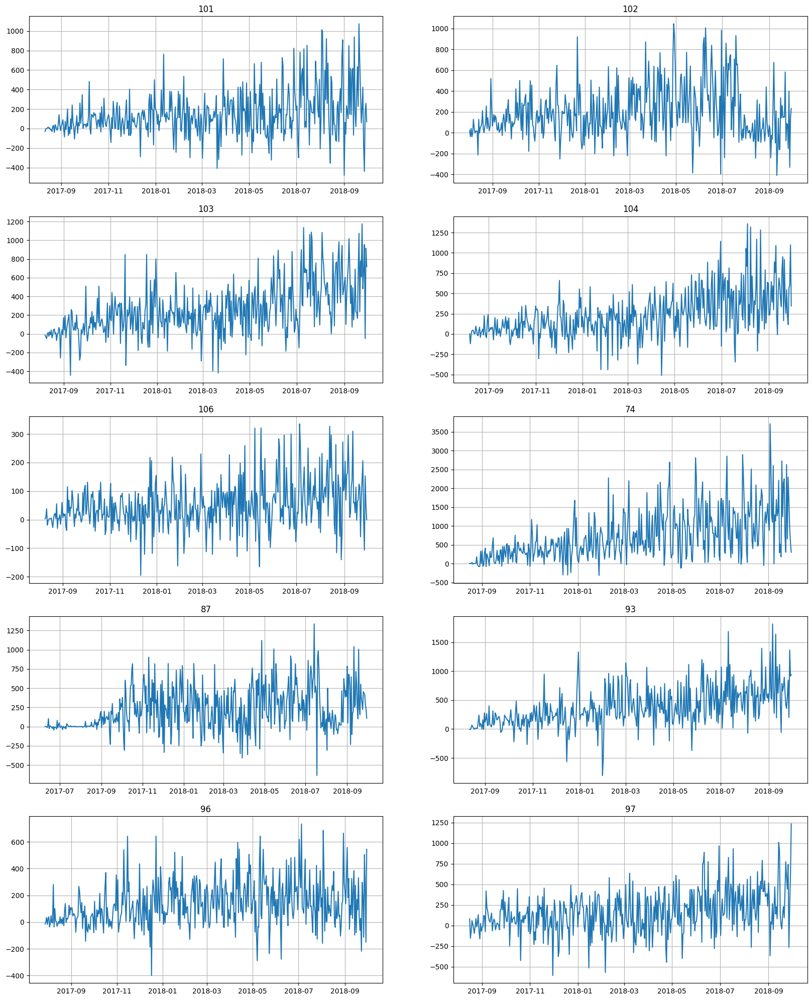

In [ ]:
df_target5 = TSDataset(df, freq="D")

df_target5.fit_transform([outliers_remover, imputer])
df_target5.plot()

In [ ]:
hs = [1, 3, 5]
models = [ProphetModel(), ProphetModel(), ProphetModel()]

ensemble = DirectEnsemble(
    assemble_pipelines(models=models, transforms=[SegmentEncoderTransform()], horizons=hs)
)

metrics_df, forecast, _ = ensemble.backtest(ts=df_target5, metrics=[SMAPE(), MAE()], aggregate_metrics=True)
metrics_df

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmplq3em7el/gvb449wc.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmplq3em7el/25k5nr6r.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=998', 'data', 'file=/tmp/tmplq3em7el/gvb449wc.json', 'init=/tmp/tmplq3em7el/25k5nr6r.json', 'output', 'file=/tmp/tmplq3em7el/prophet_modelwe_wx5ib/prophet_model-20240526134747.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:47:47 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:47:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling yearly seasonality.

,segment,SMAPE,MAE
0,100,82.969154,276.679843
1,101,89.052449,291.579981
2,102,95.354122,209.091621
3,103,58.451104,279.918940
4,104,52.655884,249.628433
5,105,82.923275,251.567178
6,106,85.103130,72.452824
7,74,55.894850,596.849119
8,85,55.323550,260.009143
9,86,64.731540,157.803907


In [ ]:
metrics[['MAE', 'SMAPE']].mean()

MAE      258.449725
SMAPE     79.463729
dtype: float64

Данный метод сработал эффективнее 2 предыдущих

### Задание 7. Ансамбли (1.25 балла)

Чтобы не выбирать лучшую модель, мы можем использовать преимущества каждой - давайте объединим все наши наработки в ансамбль. Попробуйте различные опции ансамблирования, и выберите ту, которая работает лучше всего (не забывайте, что внутри каждого ансамбля у нас тоже есть параметры, которые мы можем варьировать - веса в voting, включаемые признаки в stacking).

In [ ]:
from etna.ensembles import StackingEnsemble, VotingEnsemble

In [ ]:
pipeline1 = Pipeline(
    model=ProphetModel(),
    transforms = [
        DensityOutliersTransform(in_column="target", window_size=18, distance_coef=2 , n_neighbors=4),
        TimeSeriesImputerTransform(in_column="target", strategy="running_mean", window=30),
    ],
    horizon=HORIZON
)

pipeline2 = Pipeline(
    model=AutoARIMAModel(),
    transforms=[
       DensityOutliersTransform(in_column="target", window_size=18, distance_coef=2 , n_neighbors=4),
       TimeSeriesImputerTransform(in_column="target", strategy="running_mean", window=30),
       SegmentEncoderTransform(),
       LagTransform(in_column="target", lags=list([7, 14, 15]))
    ],

    horizon=HORIZON,
)

pipeline3 = Pipeline(
    transforms=[
       DensityOutliersTransform(in_column="target", window_size=18, distance_coef=2 , n_neighbors=4),
       TimeSeriesImputerTransform(in_column="target", strategy="running_mean", window=30),
       SegmentEncoderTransform(),
       LagTransform(in_column="target", lags=[1, 7, 14, 21]),
       STLTransform(in_column="target", period=7, model='arima')
    ],

    horizon=HORIZON,
    model=CatBoostPerSegmentModel(),
)

pipeline_names = ["prophet", "arima", "catboost"]
pipelines = [pipeline1, pipeline2, pipeline3]



In [ ]:
voting_ensemble = VotingEnsemble(pipelines=pipelines, weights= [9, 4, 2], n_jobs=4)

voting_ensamble_metrics = voting_ensemble.backtest(
    ts=df_target4,
    metrics=[SMAPE(), MAE()],
    n_folds=10,
    aggregate_metrics=True,
    n_jobs=2,
)[0].iloc[:, 1:]

voting_ensamble_metrics

[Parallel(n_jobs=2)]: Using backend MultiprocessingBackend with 2 concurrent workers.
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmplq3em7el/yrr3zcs4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmplq3em7el/l20w92uk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmplq3em7el/nlm055gl.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmplq3em7el/17xfi_yb.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', '

,SMAPE,MAE
0,91.267311,293.149146
1,99.301204,289.315117
2,124.786149,280.592000
3,55.754751,249.507284
4,59.899601,258.798558
5,87.617113,292.385516
6,92.073675,90.241035
7,48.571824,539.321453
8,65.787100,278.845360
9,82.813843,185.476136


In [ ]:
voting_ensamble_metrics[['SMAPE', 'MAE']].mean()

SMAPE     80.751125
MAE      261.298991
dtype: float64

----

In [ ]:
stacking_ensemble_unfeatured = StackingEnsemble(pipelines=pipelines, n_folds=10, n_jobs=4)

stacking_ensamble_metrics, _, _ = stacking_ensemble_unfeatured.backtest(
    ts=df_target4,
    metrics=[SMAPE(), MAE()],
    n_folds=10,
    aggregate_metrics=True,
    n_jobs=4,
)
stacking_ensamble_metrics

Выходные данные были обрезаны до нескольких последних строк (5000).
DEBUG:cmdstanpy:input tempfile: /tmp/tmplq3em7el/l0hc7wem.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=63231', 'data', 'file=/tmp/tmplq3em7el/atpg1w66.json', 'init=/tmp/tmplq3em7el/l0hc7wem.json', 'output', 'file=/tmp/tmplq3em7el/prophet_modelh79mdn0n/prophet_model-20240526162242.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
16:22:42 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:22:42 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tm

,segment,SMAPE,MAE
0,100,88.665369,283.667177
1,101,98.714492,290.002603
2,102,122.217887,286.792334
3,103,55.094022,249.546228
4,104,57.275065,245.827989
5,105,88.976012,299.222065
6,106,86.612207,85.754236
7,74,48.370662,531.220671
8,85,66.162359,279.966483
9,86,81.647202,183.960431


In [ ]:
stacking_ensamble_metrics[['SMAPE', 'MAE']].mean()

SMAPE     79.332592
MAE      259.291999
dtype: float64

Супер, 2 часа обучения. SMAPE 79.33 и MAE 259.29.

У voting ensamble
SMAPE     80.751125
MAE      261.298991

Что лучше чем у Arima и CatBoost. Но самый лучший результат был в 3 задании с обычной Prophet Model:
SMAPE     68.994229
MAE      232.650356



### Задание 8*. Трансформер (бонус 2 балла)

Для желающих протестировать мощь трансформенных моделей предлагается "завести" модель из второго семинара по временным рядам на текущем датасете. На этот раз абсолютно все необходимые импорты и зависимости подгружаются на ваше усмотрение. Удалось ли вам улучшить качество по сравнению с классическими моделями / моделями на основе ML? Что бы вы предпочли внедрить в production?

*NB:* все, конечно, прекрасно знают механизм работы бонусных заданий, но порядка ряди прописать дисклеймер должны - итоговый балл за домашнее задание ставится по формуле min(10, ваш суммарный балл за задания).

In [ ]:
#YOUR CODE HERE#